## Локальные дескрипторы изображений и построение панорам
##### Автор: [Радослав Нейчев](https://www.linkedin.com/in/radoslav-neychev/), https://t.me/s/girafe_ai

**Примечание: т.к. библиотеки регулярно обновляются, для успешного прохождения тестов рекомендуем поставить opencv версии 4.11, иначе некоторые asssert'ы могут не пройти.**

In [1]:
# !pip3 install opencv-python

In [2]:
import numpy as np
import cv2
print("OpenCV-Python Version {}".format(cv2.__version__))

OpenCV-Python Version 4.11.0


In [3]:
# do not change the code in the block below
# __________start of block__________
import json
import os
import cv2
import random
import glob
import torch

import numpy as np

from skimage import io # for io.imread
from IPython.display import clear_output
from matplotlib import pyplot as plt
from matplotlib import colors # ploting

# __________end of block__________

In [4]:
# do not change the code in the block below
# __________start of block__________
def imshow(images, titles, nrows = 0, ncols=0, figsize = (15,20)):
    """Plot a multiple images with titles.

    Parameters
    ----------
    images : image list
    titles : title list
    ncols : number of columns of subplots wanted in the display
    nrows : number of rows of subplots wanted in the figure
    """

    if ncols == 0 and nrows == 0:
      ncols = len(images)
      nrows = 1
    if ncols == 0:
      ncols = len(images) // nrows
    if nrows == 0:
      nrows = len(images) // ncols

    fig, axeslist = plt.subplots(ncols=ncols, nrows=nrows, squeeze=False, figsize = figsize)
    for i, image in enumerate(images):
        axeslist.ravel()[i].imshow(image, cmap=plt.gray(), vmin=0, vmax=255)
        axeslist.ravel()[i].set_title(titles[i])
        axeslist.ravel()[i].set_axis_off()
    plt.tight_layout() # optional
# __________end of block__________

In [121]:
if not os.path.exists('./images'):
    os.mkdir('./images')
else:
    print('folder `images` is present, passing')

# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example1_1.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example1_2.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example2_1.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example2_2.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example3_1.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example3_2.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example4_1.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example4_2.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example5_1.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example5_2.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example6_1.jpeg
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/images/example6_2.jpeg
# !mv ./example*.jpeg images

folder `images` is present, passing


In [122]:
# !wget https://raw.githubusercontent.com/girafe-ai/ml-course/refs/heads/25s_ml_trainings_3/homeworks/hw03_panorama/keypoints_sift.json

In [123]:
# do not change the code in the block below
# __________start of block__________
# Create a dictionary to store images with the same prefix
image_dict = {}

# Read all images and group them by prefix
for filename in sorted(glob.glob('./images/*.jpeg')):
    name = os.path.basename(filename)
    prefix = name.split('_')[0]  # Get prefix before first underscore

    # Load the image
    img = io.imread(filename)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Add to dictionary
    if prefix in image_dict:
        image_dict[prefix].append((img))
    else:
        image_dict[prefix] = [(img)]
# __________end of block__________

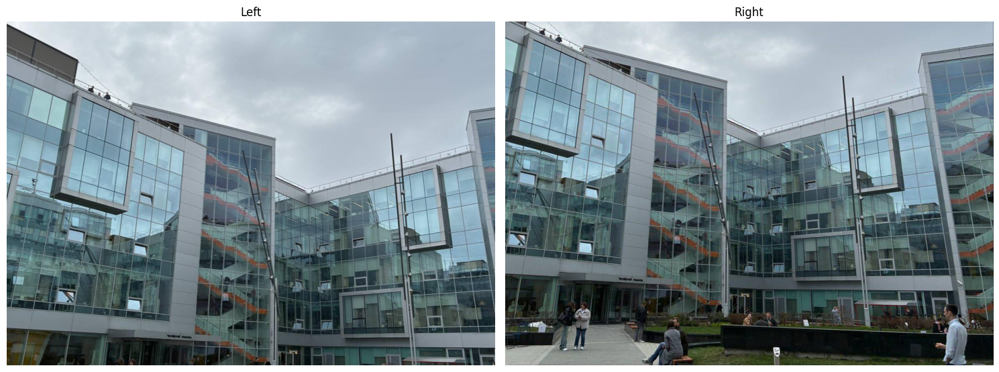

In [8]:
# do not change the code in the block below
# __________start of block__________
image1, image2 = image_dict['example2']
imshow( [image1, image2], ['Left', 'Right'])
# __________end of block__________

## Шаг 1: Создание панорамы вручную
Подберите сдвиг по координатам X и Y (`tx` и `ty` соответственно) для второго изобаражения относительно первого для задания оптимальной трансляции (смещения) для совмещения изображений вручную. Изображения имеют размеры, приведенные ниже:

In [9]:
print(f"first image shape: {image1.shape}, second image shape: {image2.shape}")

first image shape: (822, 1169, 3), second image shape: (822, 1167, 3)


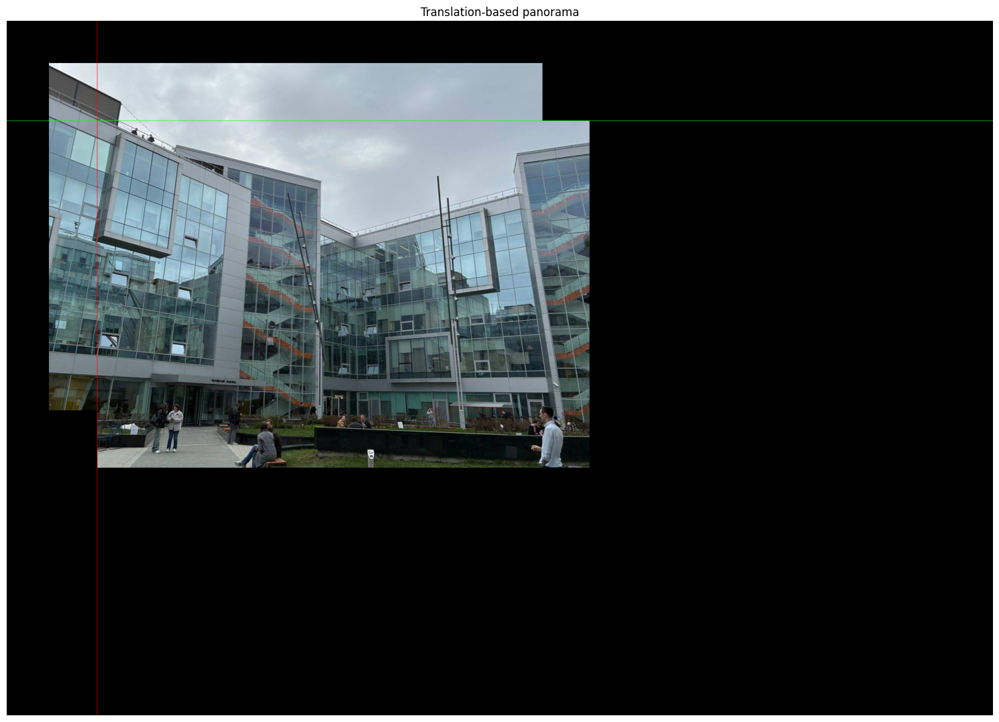

In [10]:
X_SHIFT = 100
Y_SHIFT = 100 # so you can have negative tx and ty
tx = 114 # YOUR CODE HERE 130
ty = 136 # YOUR CODE HERE 142

assert tx + X_SHIFT >= 0
assert ty + Y_SHIFT >= 0

size = (image1.shape[0] + image2.shape[0], image1.shape[1] + image2.shape[1], 3)
image_trans = np.uint8(np.zeros(size))

# put image 1 on resulting image
image_trans[Y_SHIFT:Y_SHIFT+image1.shape[0], X_SHIFT:X_SHIFT+image1.shape[1], :] = image1

# put image 2 on resulting image
image_trans[Y_SHIFT+ty:Y_SHIFT+ty+image2.shape[0], X_SHIFT+tx:X_SHIFT+tx+image2.shape[1], :] = image2

# #add vertical line where two images are joined, use red color
image_trans[:, X_SHIFT+tx, :] = [255, 0, 0]
image_trans[Y_SHIFT+ty, :, :] = [0, 255, 0]

imshow( [image_trans], ['Translation-based panorama'])

In [11]:
# do not change the code in the block below
# __________start of block__________
with open('manual_panorama.json', 'w') as iofile:
    json.dump([tx, ty], iofile)
# __________end of block__________

Вы можете сдать файл `manual_panorama.json` в задачу **Manual panorama** в соревновании.

## Шаг 2: Обнаружение ключевых точек

Используйте  **SIFT** из OpenCV (`cv2.SIFT_create`) для обнаружения ключевых точек и вычисления их дескрипторов на обоих изображениях.  
Для этого реализуйте функцию `extract_key_points`:

Алгоритм SIFT:

1) Scale-Space Peak Selection (выбор ключевой точки на разных масштабах)

   Для этого:
   - 1.1 Раделяем изображения на октавы(постоянно уменьшаем изображение в 2 раза)
   - 1.2 Блюрим изображение с помощью Гауссовского фильтра

   $$
   \begin{aligned}
       L1 = G(σ1) * I\\
       L2 = G(σ2) * I\\
       L3 = G(σ3) * I\\
       L4 = G(σ4) * I\\
       L5 = G(σ5) * I
   \end{aligned}
   $$

2) DOG(Difference of Gaussian kernel)

Формула: $DoG(x, y, σ) = G(x, y, kσ) * I(x, y) - G(x, y, σ) * I(x, y)$

   - 2.1 Вычитаем одно размытое изображение от другого по очереди

   $$
   \begin{aligned}
       DoG1 = L2 - L1\\
       DoG2 = L3 - L2\\
       DoG3 = L4 - L3\\
       DoG4 = L5 - L4
   \end{aligned}
   $$

3) Finding Keypoints

   - 3.1 Смотрим на каждый пиксель изображения: Сравниваем его с 8 соседями, 9 пикселями на предыдущем масштабе и с 9 пикселями следующего масштаба

   Локальный максимум: $D_i(x,y)>D_{i−1}(x′,y′), D_i(x,y)>D_{i}(x′,y′), D_i(x,y)>D_{i+1}(x′,y′)$

   Локальный минимум: $D_i(x,y)<D_{i−1}(x′,y′), D_i(x,y)<D_{i}(x′,y′), D_i(x,y)<D_{i+1}(x′,y′)$

   $D$ - интенсивность

4) Keypoint Localization

Хотим отфильтровать ключевые точки, ведь не все точки полезные. После обнаружения потенциальной ключевой точки мы используем разложение в ряд Тейлора для вычисления точного местоположения экстремума (ключевой точки) и его интенсивности.

Если интенсивность ключевой точки в этом месте ниже порогового значения (в статье 0,03), ключевая точка считается слишком слабой и отклоняется.

Считаем матрицу Гесса:
$$
H =
\begin{bmatrix}
D_{xx} & D_{xy} \\
D_{xy} & D_{yy}
\end{bmatrix}
$$

Где:
$$
\begin{aligned}
    D_{xx} = \frac{\partial^2 D}{\partial x^2} = D(x+1, y) + D(x-1, y) - 2 \cdot D(x, y)\\
    D_{yy} = \frac{\partial^2 D}{\partial y^2} = D(x, y+1) + D(x, y-1) - 2 \cdot D(x, y)\\
    D_{xy} = \frac{\partial^2 D}{\partial x \partial y} = \frac{1}{4} [ D(x+1, y+1) + D(x-1, y-1) - D(x-1, y+1) - D(x+1, y-1)]
\end{aligned}
$$

Затем рассчитывается отношение кривизн:

$
R = \frac{(\text{Trace}(H))^2}{\text{Det}(H)} = \frac{(D_{xx} + D_{yy})^2}{D_{xx} \cdot D_{yy} - D_{xy}^2}
$

Если $R$ слишком велик (например, $R > 10$), точка считается краевой и отбрасывается.

In [12]:
print(image1.shape)

(822, 1169, 3)


In [13]:
def extract_key_points(img1, img2):
    # YOUR CODE HERE
    if img1.shape[2] != 1:
        img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    if img2.shape[2] != 1:
        img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    kpts1, desc1 = sift.detectAndCompute(img1_gray, None) # None, None
    kpts2, desc2 = sift.detectAndCompute(img2_gray, None) # None, None
    return kpts1, desc1, kpts2, desc2

kp1, des1, kp2, des2 = extract_key_points(image1, image2)


print("Coordinates of the first keypoint of image1: ", kp1[0].pt)
print("Descriptor of the first keypoint of image1:\n", des1[0])

Coordinates of the first keypoint of image1:  (3.0671353340148926, 807.9583129882812)
Descriptor of the first keypoint of image1:
 [ 11.  23.   7.   0.   0.   2.   1.  15.  17.  20.  21.   2.   0.  12.
  47.  59.   0.   8.  44.   4.   0.  33. 124.  11.   1.   7.  23.   6.
   4.  31.  39.   2.  52.   4.   0.   0.   1.   5.   2.  32. 137.  27.
   5.   6.   3.  22.  88. 137.  19.   8.  18.  63.  34. 122. 137.  41.
   0.   1.  13.  38.  93. 120.  67.   1.  43.  15.   2.   2.   3.   2.
   1.   2. 137. 137.  68.  32.   2.   2.   3.  14.  15.  39. 137. 137.
  22.  12.   5.   4.   0.   0.  89. 116.  42.   6.   0.   0.   2.   1.
   0.   0.   0.   0.   0.   0.   6.  15.  10.   4.   0.   0.   0.   0.
   0.   3.  22.  30.   0.   0.   0.   0.   0.   0.  14.  12.   0.   0.
   0.   0.]


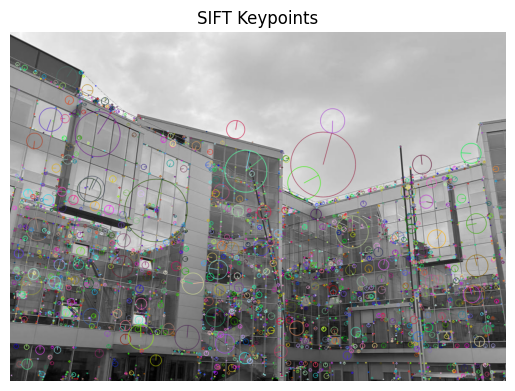

In [14]:
def draw_keypoints(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    kp = sift.detect(gray, None)
    img=cv2.drawKeypoints(gray,
                        kp,
                        img,
                        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    plt.imshow(img, cmap='gray')
    plt.title('SIFT Keypoints')
    plt.axis('off')
    plt.show()

draw_keypoints(image1)

In [15]:
# do not change the code in the block below
# __________start of block__________
with open('keypoints_sift.json', 'r') as f:
    loaded_data = json.load(f)

for kp, loaded_kp in zip(kp1[:10], loaded_data['keypoints1']):
    assert np.allclose(kp.pt, loaded_kp, atol=1e-5), f"keypoint {kp.pt} and {loaded_kp} are not close"
# __________end of block__________

## Шаг 3: Сопоставление ключевых точек  
Далее необходимо сопоставить признаки между изображениями. Существует множество стратегий сопоставления, давайте используем самый простой подход, реализованный в [BFMatcher](https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_feature2d/py_matcher/py_matcher.html) (от Brute Force).

Оценить качество сопоставления ключевых точек можно на основе аттрибута `distance`. Полезно отсортировать соответствия по возрастанию расстояния, чтобы первые элементы списка были наиболее релевантными.

In [16]:
# do not change the code in the block below
# __________start of block__________
def match_key_points_cv(des1, des2):
    bf =  cv2.BFMatcher(crossCheck=True)
    matches = bf.match(des1, des2)

    sorted_matches = sorted(matches, key = lambda x:x.distance)
    return sorted_matches

def showMatches(img1, kp1, img2, kp2, matches, name):
    img = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    imshow([img],[name])
# __________end of block__________

2339


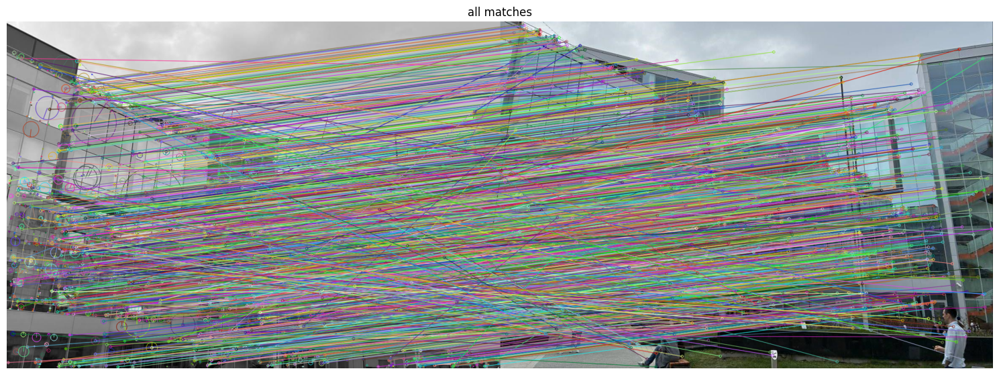

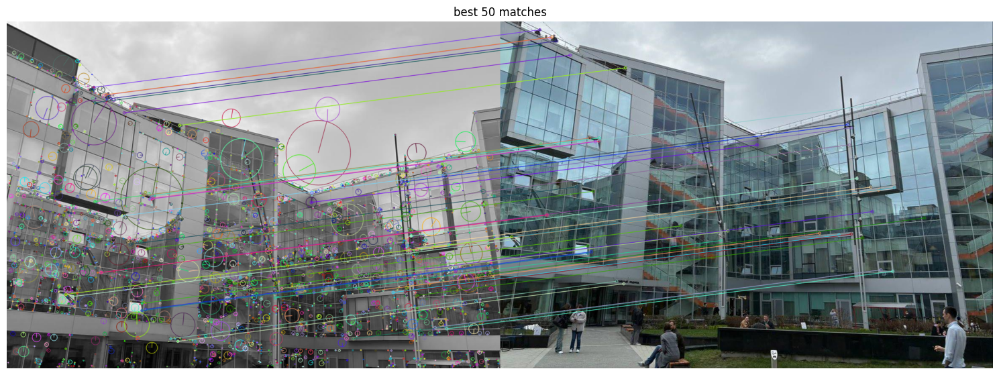

In [17]:
matches_cv = match_key_points_cv(des1, des2)

print(len(matches_cv))
showMatches(image1,kp1,image2,kp2,matches_cv,"all matches")
showMatches(image1,kp1,image2,kp2,matches_cv[:50],"best 50 matches")

Ваша задача: реализовать аналог `BFMatcher`, используя чистый `numpy`. Он основан на подсчете разницы между дескрипторами изображений и вычисляется следующим образом:

1. Подсчет матрицы попарных расстояний между дескрипторами обоих изображений.
2. Для каждого дескриптора изображения 1 находится наиболее похожий (ближайший) дескриптор изображения 2.
2. Для каждого дескриптора изображения 2 находится наиболее похожий (ближайший) дескриптор изображения 1.
4. Те пары дескрипторов, которые совпали (т.е. дескрипторы ближайшие друг для друга) считаются парами.

Шаблоны кода написаны ниже.

In [33]:
# do not change the code in the block below
# __________start of block__________
class DummyMatch:
    def __init__(self, queryIdx, trainIdx, distance):
        self.queryIdx = queryIdx  # index in des1
        self.trainIdx = trainIdx  # index in des2
        self.distance = distance
# __________end of block__________

from tqdm.notebook import tqdm

def match_key_points_numpy(des1: np.ndarray, des2: np.ndarray) -> list:
    """
    Match descriptors using brute-force matching with cross-check.

    Args:
        des1 (np.ndarray): Descriptors from image 1, shape (N1, D)
        des2 (np.ndarray): Descriptors from image 2, shape (N2, D)

    Returns:
        List[DummyMatch]: Sorted list of mutual best matches.
    """
    # YOUR CODE HERE
    matches = []
    des1_best_matches = {}
    des2_best_matches = {}

    for ind_i, i in enumerate(tqdm(des1)):
        best_distance = float('inf')
        best_j = -1
        for ind_j, j in enumerate(des2):
            distance = np.linalg.norm(i - j)
            if distance < best_distance:
                best_distance = distance
                best_j = ind_j
        des1_best_matches[ind_i] = (best_j, best_distance)

    for ind_j, j in enumerate(tqdm(des2)):
        best_distance = float('inf')
        best_i = -1
        for ind_i, i in enumerate(des1):
            distance = np.linalg.norm(j - i)
            if distance < best_distance:
                best_distance = distance
                best_i = ind_i
        des2_best_matches[ind_j] = (best_i, best_distance)

    for i, (j, dist) in des1_best_matches.items():
        best_i_for_j, _ = des2_best_matches[j]
        if best_i_for_j == i:
            matches.append(DummyMatch(i, j, dist))

    matches.sort(key=lambda m: m.distance)
    return matches

In [46]:
def match_key_points_numpy(des1: np.ndarray, des2: np.ndarray, batch_size=256) -> list:
    matches = []

    # Найдем best match для des1 → des2
    des1_best = np.full((des1.shape[0],), -1, dtype=int)
    des1_dist = np.full((des1.shape[0],), np.inf)

    for start in tqdm(range(0, des2.shape[0], batch_size), desc="Matching des1 to des2"):
        end = start + batch_size
        batch = des2[start:end]  # (B, D)
        dists = np.linalg.norm(des1[:, None, :] - batch[None, :, :], axis=2)  # (N1, B)
        min_idx = np.argmin(dists, axis=1)
        min_dists = np.min(dists, axis=1)

        update_mask = min_dists < des1_dist
        des1_dist[update_mask] = min_dists[update_mask]
        des1_best[update_mask] = start + min_idx[update_mask]

    # Аналогично: best match для des2 → des1
    des2_best = np.full((des2.shape[0],), -1, dtype=int)
    des2_dist = np.full((des2.shape[0],), np.inf)

    for start in tqdm(range(0, des1.shape[0], batch_size), desc="Matching des2 to des1"):
        end = start + batch_size
        batch = des1[start:end]
        dists = np.linalg.norm(des2[:, None, :] - batch[None, :, :], axis=2)  # (N2, B)
        min_idx = np.argmin(dists, axis=1)
        min_dists = np.min(dists, axis=1)

        update_mask = min_dists < des2_dist
        des2_dist[update_mask] = min_dists[update_mask]
        des2_best[update_mask] = start + min_idx[update_mask]

    # Cross-check
    for i in range(des1.shape[0]):
        j = des1_best[i]
        if j >= 0 and des2_best[j] == i:
            matches.append(DummyMatch(i, j, des1_dist[i]))

    matches.sort(key=lambda m: m.distance)
    return matches


Проверка:

In [47]:
# do not change the code in the block below
# __________start of block__________
def test_numpy_bf_matcher_equivalence(des1, des2):
    # OpenCV BFMatcher
    cv_matches = match_key_points_cv(des1, des2)

    # Our matcher
    np_matches = match_key_points_numpy(des1, des2)

    # Compare match indices and distances
    assert len(cv_matches) == len(np_matches), f"Match count mismatch: {len(cv_matches)} vs {len(np_matches)}"

    for idx, (m_cv, m_np) in enumerate(zip(cv_matches, np_matches)):
        assert m_cv.queryIdx == m_np.queryIdx
        assert m_cv.trainIdx == m_np.trainIdx
        assert abs(m_cv.distance - m_np.distance) < 1e-4, f"Distance mismatch on {idx}th match: {m_cv.distance:.4f} vs {m_np.distance:.4f}"

    print("Your numpy implementation matches OpenCV BFMatcher output!")

test_numpy_bf_matcher_equivalence(des1, des2)
# __________end of block__________

Matching des1 to des2:   0%|          | 0/18 [00:00<?, ?it/s]

Matching des2 to des1:   0%|          | 0/15 [00:00<?, ?it/s]

Your numpy implementation matches OpenCV BFMatcher output!


Сдайте функцию `match_key_points_numpy` в задачу **BFMatcher** в соревновании.

## Шаг 4 (опциональный): Оценка матрицы гомографии с использованием DLT и RANSAC

Функция cv2.findHomography оценивает гомографию, которая преобразует исходные точки в целевые. При использовании метода RANSAC она устойчива к выбросам. Ниже доступна реализация функции с использованием RANSAC, а также с использованием более простого метода DLT.

Ваша опциональная задача: реализовать DLT на чистом `numpy`.

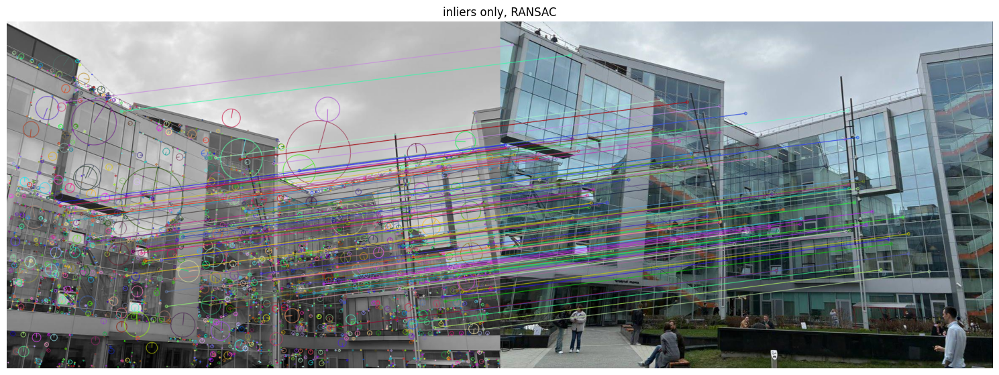

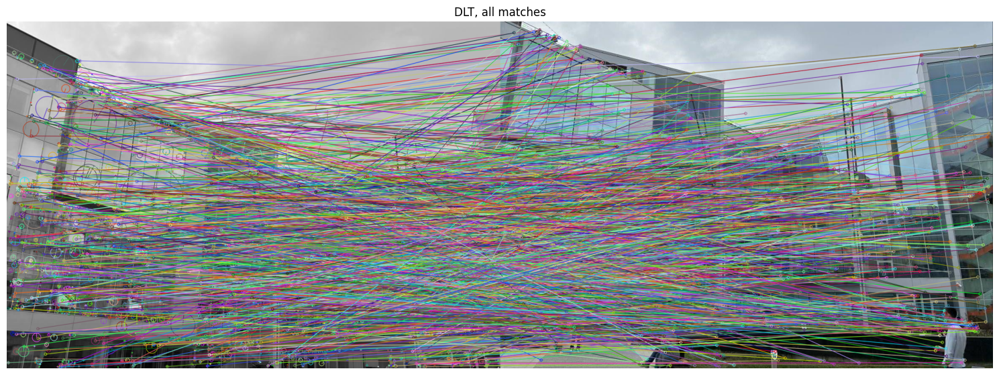

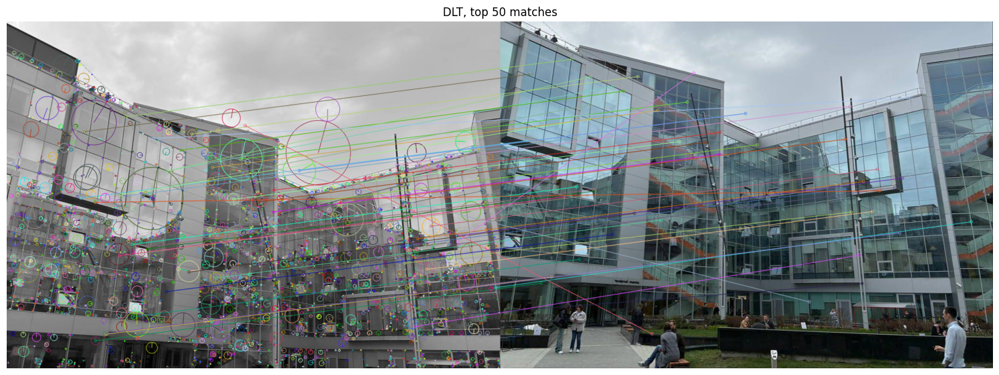

In [85]:
# do not change the code in the block below
# __________start of block__________
def findHomography_dlt_opencv(matches, keypoint1, keypoint2, mode='DLT'):

    src_pts = np.float32([keypoint1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([keypoint2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)

    if mode == 'DLT':
        mode = 0
    elif mode == 'RANSAC':
        mode = cv2.RANSAC
    H, mask = cv2.findHomography(src_pts, dst_pts, mode)
    mask = mask.ravel().tolist()

    inliers = []
    for i in range(len(mask)):
      if mask[i] == 1:
        inliers.append(matches[i])

    return H, inliers


H_for_panorama, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'RANSAC')
showMatches(image1,kp1,image2,kp2,inliers,"inliers only, RANSAC")


H, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'DLT')
showMatches(image1,kp1,image2,kp2,inliers,"DLT, all matches")

H, inliers = findHomography_dlt_opencv(matches_cv[:50], kp1, kp2, 'DLT')
showMatches(image1,kp1,image2,kp2,inliers,"DLT, top 50 matches")

# __________end of block__________

Ручная реализация DLT нетривиальна и опциональна. Пример с развернутым описанием и разбором можно найти, например, [здесь](https://medium.com/@insight-in-plain-sight/estimating-the-homography-matrix-with-the-direct-linear-transform-dlt-ec6bbb82ee2b).
Т.к. тонкости реализации могут варьироваться (например, нормировка), оценка похожести матрицы `H`, полученной с помощью вашей реализации и реализации `opencv` достаточно грубая.
Рекомендуем опираться также на визуальную проверку сопоставления изображений ниже.

In [64]:
from tqdm.notebook import tqdm
def dlt_homography_normalized(pts1: np.ndarray, pts2: np.ndarray) -> np.ndarray:
    """
    Computes homography matrix using normalized Direct Linear Transform (DLT).

    Args:
        pts1 (np.ndarray): Source points (N, 2)
        pts2 (np.ndarray): Destination points (N, 2)

    Returns:
        np.ndarray: Homography matrix (3x3)
    """
    # YOUR CODE HERE
    N = len(pts1)  # Number of point correspondences
    # Construct matrix A (2N x 8)
    A = []
    for i in tqdm(np.arange(N)):
        x1, y1 = pts1[i]
        x2, y2 = pts2[i]
        A.append([x1, y1, 1, 0, 0, 0, -x2*x1, -x2*y1, x2])  # First equation
        A.append([0, 0, 0, x1, y1, 1, -y2*x1, -y2*y1, y2])  # Second equation
    A = np.array(A)
    # Solve the system A * h = 0 using Singular Value Decomposition (SVD)
    U, S, Vt = np.linalg.svd(A)
    # The solution to the system is the last column of Vt (right singular vectors)
    h = Vt[-1, :]  # Homography vector
    # Reshape into the 3x3 matrix H
    H = h.reshape(3, 3)
    # Normalize H (set the last element to 1)
    H = H / H[2, 2]
    return H

def findHomography_dlt_numpy(matches, keypoint1, keypoint2):
    src_pts = np.float32([keypoint1[m.queryIdx].pt for m in matches])
    dst_pts = np.float32([keypoint2[m.trainIdx].pt for m in matches])
    return dlt_homography_normalized(src_pts, dst_pts), None

In [82]:
import numpy as np

def normalize_points(pts):
    """
    Normalize points so that the centroid is at the origin
    and the RMS distance from the origin is sqrt(2).
    Returns:
      pts_norm: (N×2) array of normalized coordinates
      T:       (3×3) normalization matrix
    """
    # 1) centroid
    mean = np.mean(pts, axis=0)

    # 2) compute RMS distance from mean
    diffs = pts - mean[None, :]
    d2 = np.sum(diffs*diffs, axis=1)         # squared distances
    rms = np.sqrt(np.mean(d2))               # root-mean-square

    # 3) scale factor so that RMS → sqrt(2)
    scale = np.sqrt(2.0) / rms

    # 4) build similarity transform
    T = np.array([
        [scale,     0,   -scale * mean[0]],
        [    0, scale,   -scale * mean[1]],
        [    0,     0,                 1]
    ], dtype=float)

    # 5) apply to points (homogeneous)
    pts_h = np.hstack([pts, np.ones((pts.shape[0], 1))])
    pts_norm = (T @ pts_h.T).T
    return pts_norm[:, :2], T

def dlt_homography_normalized(pts1, pts2):
    """
    Normalized DLT to estimate H mapping pts1 → pts2.
    """
    assert pts1.shape == pts2.shape and pts1.shape[0] >= 4

    # Normalize both point sets
    pts1_n, T1 = normalize_points(pts1)
    pts2_n, T2 = normalize_points(pts2)

    # Build 2N×9 linear system A h = 0
    N = pts1_n.shape[0]
    A = np.zeros((2*N, 9), dtype=float)
    for i in range(N):
        x1, y1 = pts1_n[i]
        x2, y2 = pts2_n[i]
        A[2*i    ] = [-x1, -y1, -1, 0,   0,   0, x2*x1, x2*y1, x2]
        A[2*i + 1] = [  0,   0,  0, -x1, -y1, -1, y2*x1, y2*y1, y2]

    # Solve for h as the null‐space (SVD)
    _, _, Vt = np.linalg.svd(A)
    Hn = Vt[-1].reshape(3, 3)
    Hn /= Hn[2, 2]        # normalize

    # Denormalize: H = T2⁻¹ · Hn · T1
    H = np.linalg.inv(T2) @ Hn @ T1
    H /= H[2, 2]
    return H

def findHomography_dlt_numpy(matches, kp1, kp2):
    src = np.float64([kp1[m.queryIdx].pt for m in matches])
    dst = np.float64([kp2[m.trainIdx].pt for m in matches])
    H = dlt_homography_normalized(src, dst)
    return H, matches


Т.к. DLT неустойчив к выбросам (и вообще достаточно прост), будем использовать `NUM_BEST_MATCHES` лучших совпадений

In [83]:
# do not change the code in the block below
# __________start of block__________
NUM_BEST_MATCHES = 50

kp1, des1, kp2, des2 = extract_key_points(*image_dict['example2'])
matches_cv = match_key_points_cv(des1, des2)

H_numpy, _ = findHomography_dlt_numpy(matches_cv[:NUM_BEST_MATCHES], kp1, kp2)
H, _ = findHomography_dlt_opencv(matches_cv[:NUM_BEST_MATCHES], kp1, kp2, mode='DLT')
assert np.allclose(H_numpy, H, atol=2e-1), f"Homography matrices are too different!\nH_numpy:\n{H_numpy}\nH from opencv:\n{H}"
# __________end of block__________

AssertionError: Homography matrices are too different!
H_numpy:
[[-7.87237174e-01 -1.19870848e+00  4.10182842e+02]
 [ 1.46234526e+00 -6.71158392e+00  1.60546331e+03]
 [ 2.61514980e-03 -8.76428172e-03  1.00000000e+00]]
H from opencv:
[[ 9.17839608e-01 -1.62084085e-01  7.30801173e+01]
 [-6.98774517e-02  1.01037848e+00 -5.45131943e+01]
 [-8.38459848e-05  2.72995878e-04  1.00000000e+00]]

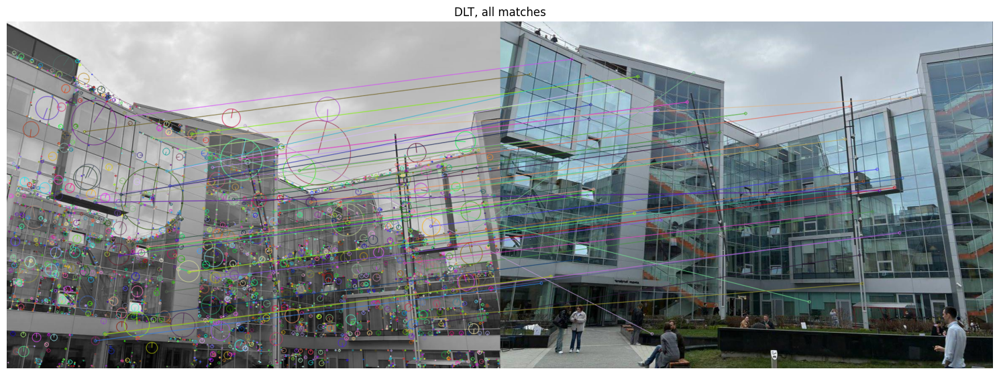

In [89]:
NUM_BEST_MATCHES = 50

kp1, des1, kp2, des2 = extract_key_points(*image_dict['example2'])
matches_cv = match_key_points_cv(des1, des2)

H_numpy, inliers = findHomography_dlt_numpy(matches_cv[:NUM_BEST_MATCHES], kp1, kp2)
showMatches(np.array(image_dict['example2'][0]),kp1,np.array(image_dict['example2'][1]),kp2,inliers,"DLT, all matches")

In [98]:
H_numpy

array([[-7.87237174e-01, -1.19870848e+00,  4.10182842e+02],
       [ 1.46234526e+00, -6.71158392e+00,  1.60546331e+03],
       [ 2.61514980e-03, -8.76428172e-03,  1.00000000e+00]])

## Шаг 5. Построение панорамы
Используя матрицу гомографии `H` можно совместить две фотографии. Функция реализована для вас. Сравните с результатом, полученным вручную на шаге 1.

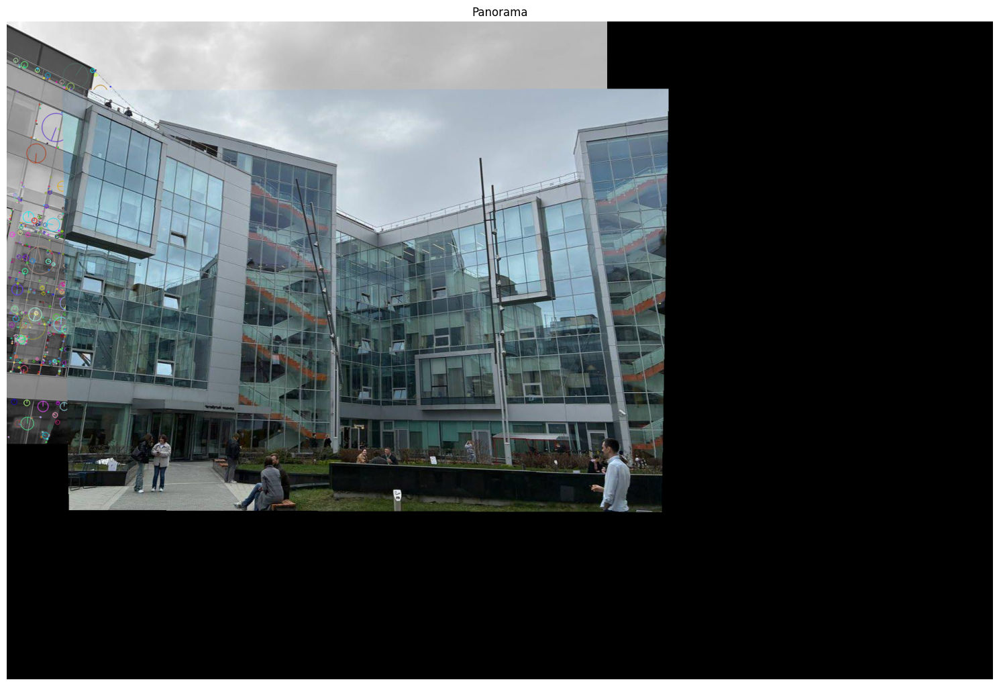

In [86]:
def panorama(img1, img2, H, size):
    img = np.uint8(np.zeros(size))
    img = cv2.warpPerspective(src=img1, dst=img, M=np.eye(3), dsize=(size[1], size[0]))
    img = cv2.warpPerspective(src=img2, dst=img, M=H, dsize=(size[1], size[0]), flags=cv2.WARP_INVERSE_MAP, borderMode=cv2.BORDER_TRANSPARENT)

    return img

size = (1280, 960*2, 3)
imshow([panorama(image1, image2, H_for_panorama, size)],["Panorama"])

## Шаг 6: Функция для построения панорам
Осталось лишь собрать воедино ваши наработки (кроме ручного DLT) и получить функцию, которая на входе имеет два изображения, а на выходе возвращает совмещенное изображение и матрицу `H`.
Благодаря использованию SIFT угол съемки может варьироваться.

Обращаем ваше внимание, даже при правильной реализации на одном из примеров панорама не будет строиться корректно (`example_5`), это нормально.

**Примечание: т.к. вариантов построения данной функции много, для успешного прохождения тестов в контесте используйте следующую последовательность:**
1. Обнаружение ключевых точек с помощью фунции `extract_key_points` с SIFT под капотом (она уже реализована выше).
2. Для сопоставления ключевых точек используйте функцию `match_key_points_cv` (она также реализована).
3. Для определения матрицы гомографии используйте `findHomography_dlt_opencv` с методом `RANSAC` (также реализована).

In [125]:
def panorama_pipeline(img1, img2, size):
    # YOUR CODE HERE
    kp1, des1, kp2, des2 = extract_key_points(img1, img2)
    matches_cv = match_key_points_cv(des1, des2)
    H, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'RANSAC')
    # warped_img2 = cv2.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))  # width, height
    # res = cv2.hconcat([img1, warped_img2])
    return panorama(img1, img2, H, size), H

In [136]:
def panorama_pipeline(img1, img2, size):
    """
    Строит панораму из двух изображений, используя 50 лучших матчей и RANSAC-гомографию.
    """
    # 1. Извлечение ключевых точек и дескрипторов
    kp1, des1, kp2, des2 = extract_key_points(img1, img2)

    # 2. Поиск совпадений
    matches = match_key_points_cv(des1, des2)

    # 3. Отбор 50 лучших
    NUM_BEST_MATCHES = 50
    best_matches = matches[:NUM_BEST_MATCHES]

    # 4. Гомография с RANSAC на основе лучших матчей
    H, _ = findHomography_dlt_opencv(best_matches, kp1, kp2, mode='RANSAC')

    # 5. Создание панорамы
    res = panorama(img1, img2, H, size)

    return res, H



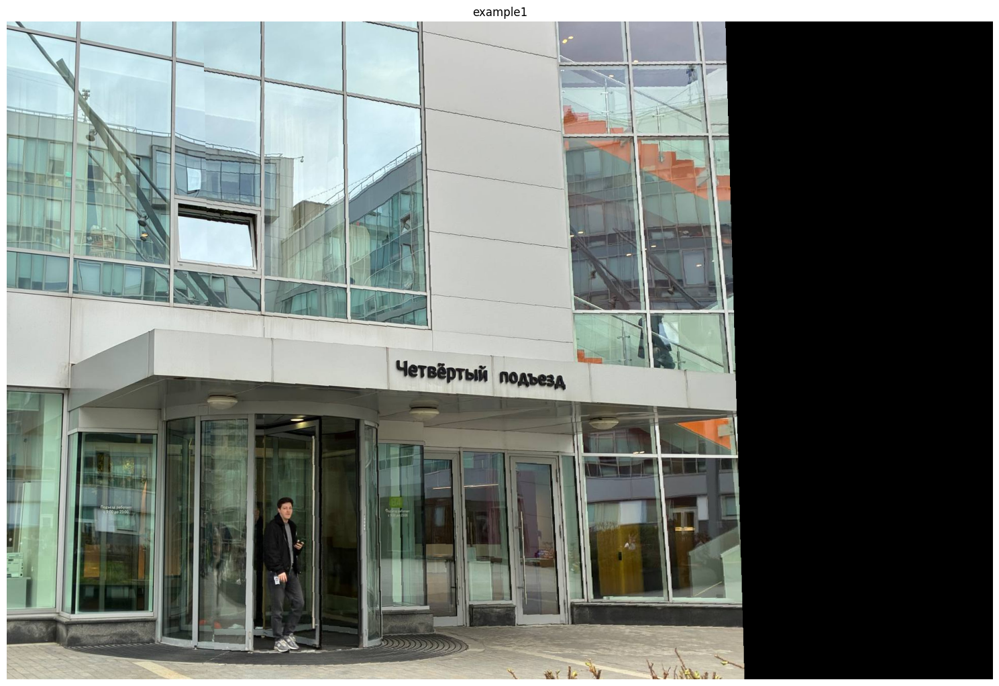

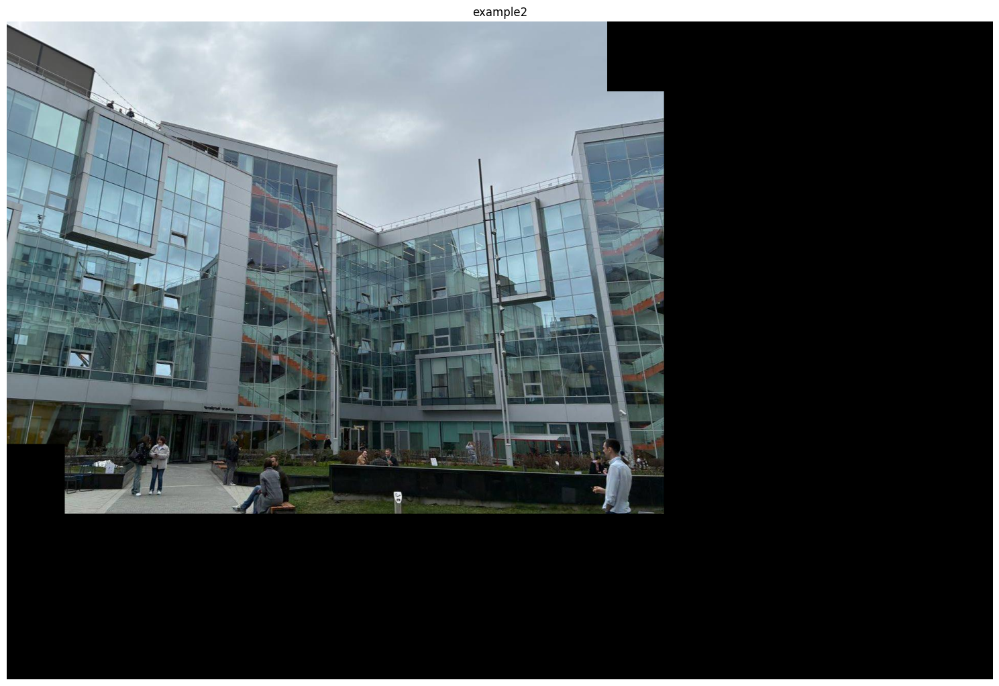

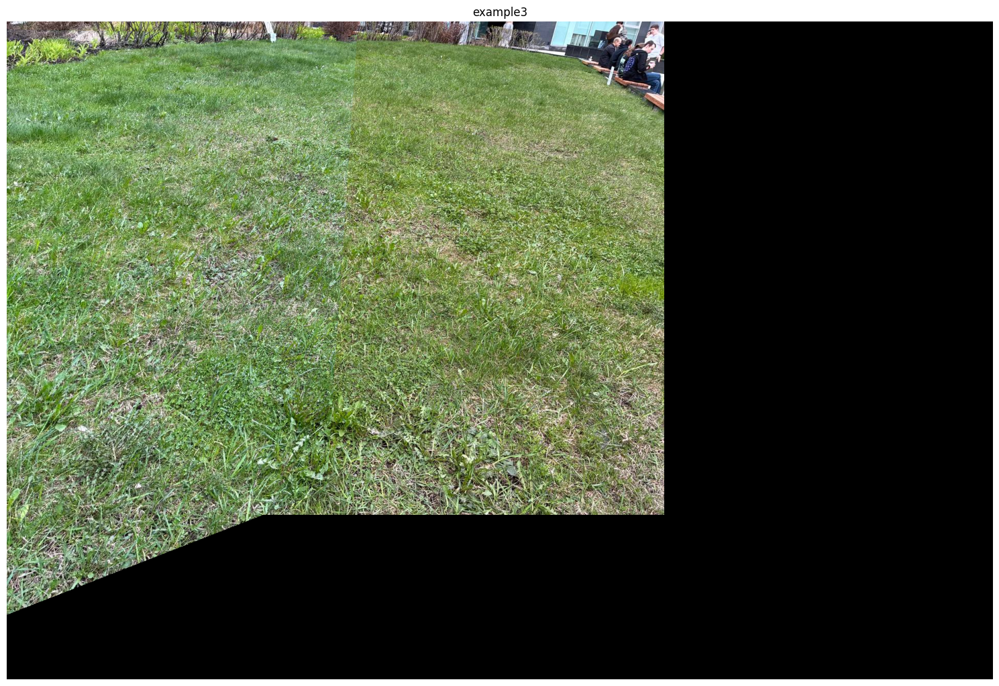

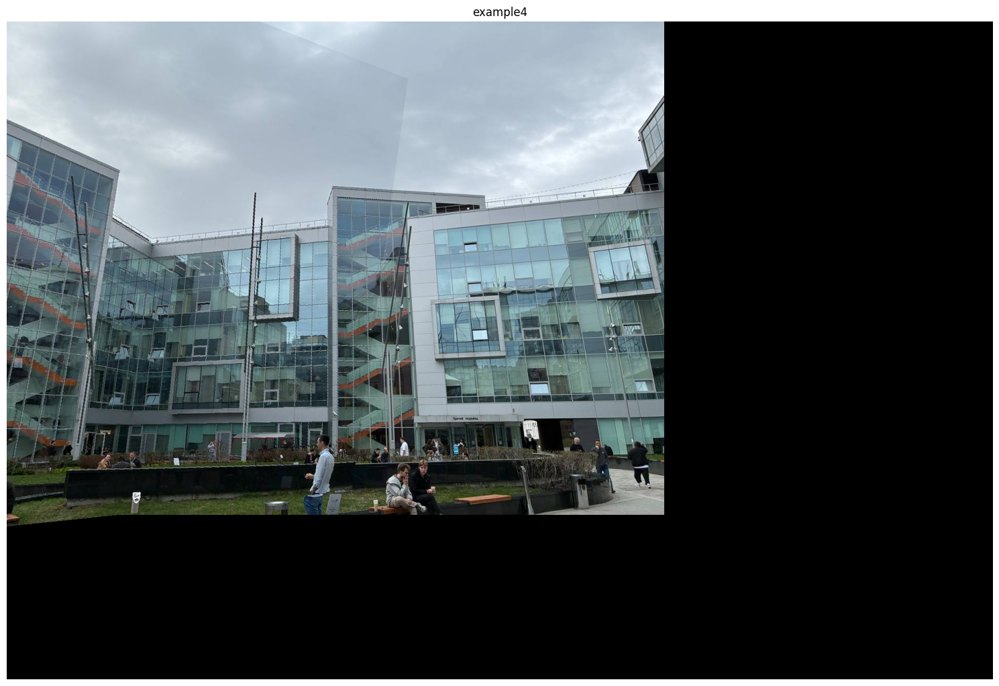

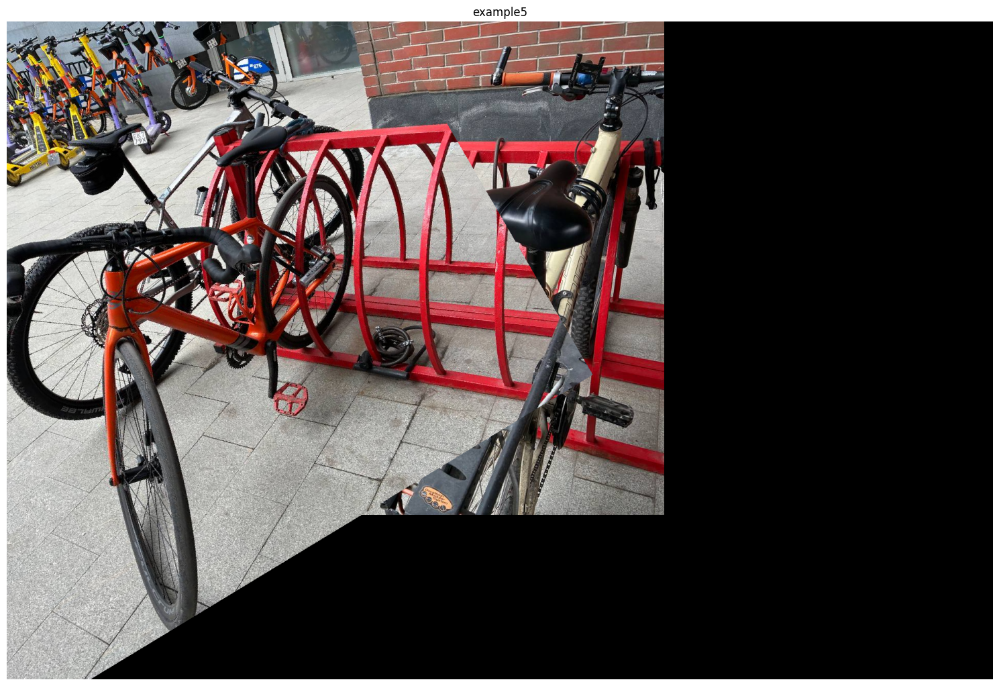

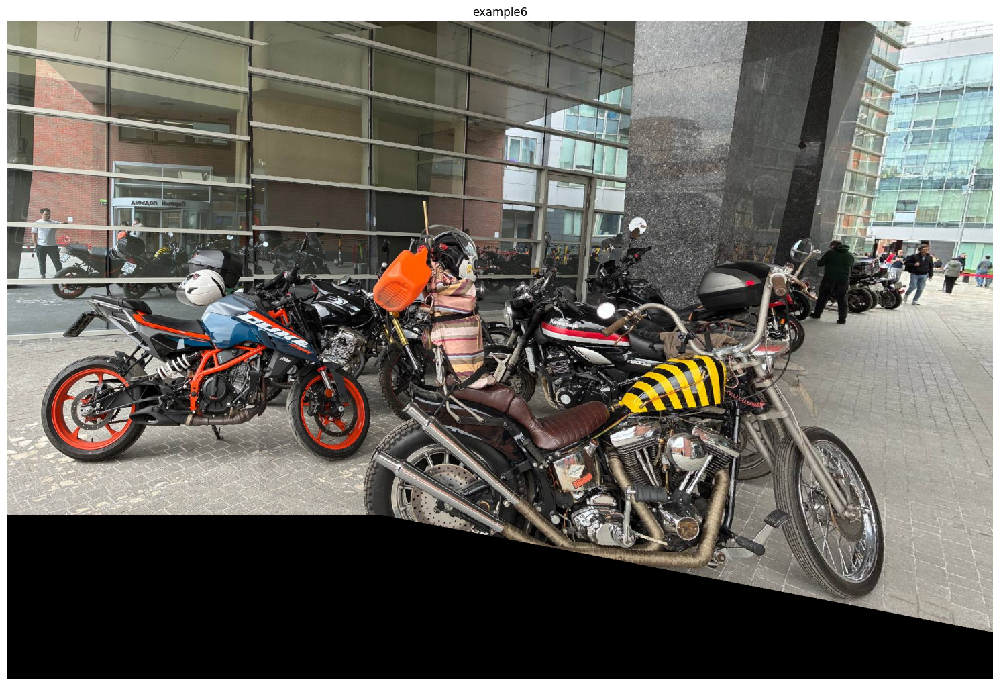

In [137]:
# do not change the code in the block below
# __________start of block__________
size = (1280, 960*2, 3)
h_dict = {}

for filename, (img1, img2) in image_dict.items():
    final_image, H = panorama_pipeline(img1, img2, size)
    h_dict[filename] = H.tolist()
    imshow([final_image],[filename])

with open('h_submission_dict.json', 'w') as iofile:
    json.dump(h_dict, iofile)
# __________end of block__________

Сдайте `h_submission_dict.json` в задачу **Homography mapping**.

## Шаг 7: Ваш telegram login
Запишите ваш telegram login в формате ссылки https://t.me/username в строку ниже. Он будет нужен для участия в тестах.

In [ ]:
your_telegram_login = 'https://t.me/Temablag'

# do not change the code in the block below
# __________start of block__________
assert your_telegram_login[:13] == 'https://t.me/'
assert '@' not in your_telegram_login

with open('telegram_login.json', 'w') as iofile:
    json.dump([your_telegram_login], iofile)
# __________end of block__________

## Сдача задания
Для сдачи задания вам необходимо:
 * Сдать файл `manual_panorama.json` в задачу **Manual panorama** в соревновании.
 * Сдать функцию `match_key_points_numpy` в задачу **BFMatching** в соревновании.
 * Сдать `h_submission_dict.json` в задачу **Homography mapping**.
 * Сдать `telegram_login.json` в задачу **telegram_login** для участия в тестах.

Не забудьте, что при сдаче кода все импортируемые библиотеки также должны вставляться вместе с вашим кодом. Вы не должны использовать что-либо, кроме `numpy` при написании решения.

На этом задание завершено. Поздравляем!